In [1]:
from datascience import *
import numpy as np

In [2]:
import matplotlib
%matplotlib inline
import matplotlib.pyplot as plots
plots.style.use('fivethirtyeight')

In this lecture, I am going to use more interactive plots (they look better) so I am using the plotly.express library.  We won't test you on this but it's good to know.

In [3]:
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Lecture 12

In this lecture, we will explore the use of optimization to find the "best" model and derive least-squares regression.

## Review From Last Lecture

In the last lecture we developed the equations of slope and intercept using the correlation coefficient $r$.

### Standard Units

$$
\text{StandardUnits}(x) = \frac{x - \text{Mean}(x)}{\text{Stdev}(x)} 
$$

In [4]:
def standard_units(x):
    """Converts an array x to standard units"""
    return (x - np.mean(x)) / np.std(x)

### Correlation

$$
\begin{align}
r 
& = \text{Mean}\left(\text{StandardUnits}(x) *  \text{StandardUnits}(y)\right)\\
& = \frac{1}{n} \sum_{i=1}^n \text{StandardUnits}(x_i) *  \text{StandardUnits}(y_i)\\
& = \frac{1}{n}\sum_{i=1}^n \left( \frac{x_i - \text{Mean}(x)}{\text{Stdev}(x)} \right) * \left( \frac{y_i - \text{Mean}(y)}{\text{Stdev}(y)} \right) \\
\end{align}
$$

In [5]:
def correlation(t, x, y):
    """Computes the correlation between columns x and y"""
    x_su = standard_units(t.column(x))
    y_su = standard_units(t.column(y))
    return np.mean(x_su * y_su)

### Slope and Intercept

$$
\begin{align}
\text{slope} &= r * \frac{\text{Stdev}(y)}{\text{Stdev}(x)}\\
\text{intercept} & = \text{Mean}(y) - \text{slope} * \text{Mean}(x)
\end{align}
$$

In [6]:
def slope(t, x, y):
    """Computes the slope of the regression line"""
    y_std = np.std(t.column(y))
    x_std = np.std(t.column(x))
    r = correlation(t,x,y)
    return r * (y_std/x_std)

In [7]:
def intercept(t, x, y):
    """Computes the intercept of the regression line"""
    y_mean = np.mean(t.column(y))
    x_mean = np.mean(t.column(x))
    return y_mean - slope(t,x,y)*x_mean

### Linear Prediction

$$
y_\text{predicted} = \text{slope} * x + \text{intercept}
$$


In [8]:
def predict_linear(t, x, y):
    """Return an array of the regressions estimates at all the x values"""
    pred_y = slope(t,x,y) * t.column(x) + intercept(t,x,y)
    return pred_y

<br><br><br>

---

## Making Predictions with Linear Regression

We can now compute predictions, but how good are they?  How do we know that we have a good linear fit? To study this we will consider a new dataset.

In [9]:
demographics = Table.read_table('data/district_demographics2016.csv')
demographics.show(5)

State,District,Median Income,Percent voting for Clinton,College%
Alabama,"Congressional District 1 (115th Congress), Alabama",47083,34.1,24
Alabama,"Congressional District 2 (115th Congress), Alabama",42035,33,21.8
Alabama,"Congressional District 3 (115th Congress), Alabama",46544,32.3,22.8
Alabama,"Congressional District 4 (115th Congress), Alabama",41110,17.4,17
Alabama,"Congressional District 5 (115th Congress), Alabama",51690,31.3,30.3


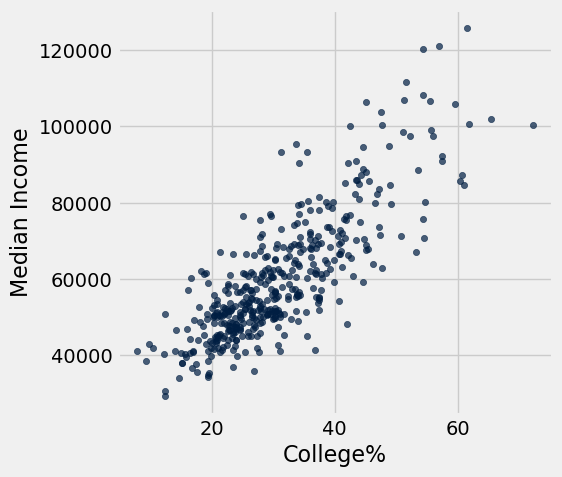

In [10]:
demographics.scatter("College%", "Median Income")

In [11]:
correlation(demographics, 'College%', 'Median Income')

0.81846485171413352

**Discussion Question:** Any concerns about the correlation computation being done here?

In [ ]:
# take some time here to write your response...


### Making Predictions

Here we will try to predict the income for each district as a function of the percent of college educated people.

In [14]:
demo_slope = slope(demographics, 'College%', 'Median Income')
demo_intercept = intercept(demographics, 'College%', 'Median Income')
print('Slope: ', demo_slope)
print('Intercept: ', demo_intercept)

# Slope: change in y / change in x = change in median income / change in college % = Increase of $1270 in median income with each % increase
# in college education (for our prediction line)

# 0% college educated district (hypothetically), we would predict a median income of $20,802.58

Slope:  1270.70168946
Intercept:  20802.5777667


Make the actual predictions.

**Discussion Questions**
- How do we interpret the slope and intercept?

In [15]:
demographics = demographics.with_column('Linear Prediction', predict_linear(demographics, 'College%', 'Median Income'))
demographics

State,District,Median Income,Percent voting for Clinton,College%,Linear Prediction
Alabama,"Congressional District 1 (115th Congress), Alabama",47083,34.1,24,51299.4
Alabama,"Congressional District 2 (115th Congress), Alabama",42035,33,21.8,48503.9
Alabama,"Congressional District 3 (115th Congress), Alabama",46544,32.3,22.8,49774.6
Alabama,"Congressional District 4 (115th Congress), Alabama",41110,17.4,17,42404.5
Alabama,"Congressional District 5 (115th Congress), Alabama",51690,31.3,30.3,59304.8
Alabama,"Congressional District 6 (115th Congress), Alabama",61413,26.1,36.7,67437.3
Alabama,"Congressional District 7 (115th Congress), Alabama",34664,69.8,19.4,45454.2
Alaska,"Congressional District (at Large) (115th Congress), Alaska",76440,37.6,29.6,58415.3
Arizona,"Congressional District 1 (115th Congress), Arizona",50537,46.6,24.5,51934.8
Arizona,"Congressional District 2 (115th Congress), Arizona",49072,49.6,34,64006.4


**Question**
- Why do I predict data I already have?

In [ ]:
# write your response here
# we first assess how well/bad our predictions are
# before we take the risk of making predictions on outcomes we do not yet know
# in other words, if our ways of making predictions are sound
# they should produce minimal error on our given dataset, where we know the outcomes attached (median income, y-values)
# first test predictions on dataset where you know the outcomes
# then and only then do you make predictions on outcomes that you do not know

Visualizing the predictions:

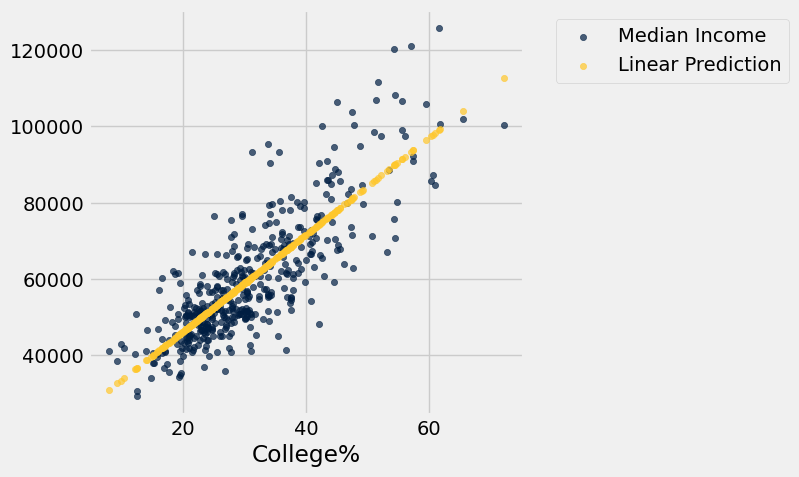

In [16]:
demographics.scatter('College%', ["Median Income", "Linear Prediction"])

In [17]:
def draw_line(intercept=0, slope=1):
    plots.axline(xy1=(0, intercept), slope=slope)    

def draw_vline(x_pos):
    plots.axvline(x_pos, color='black')

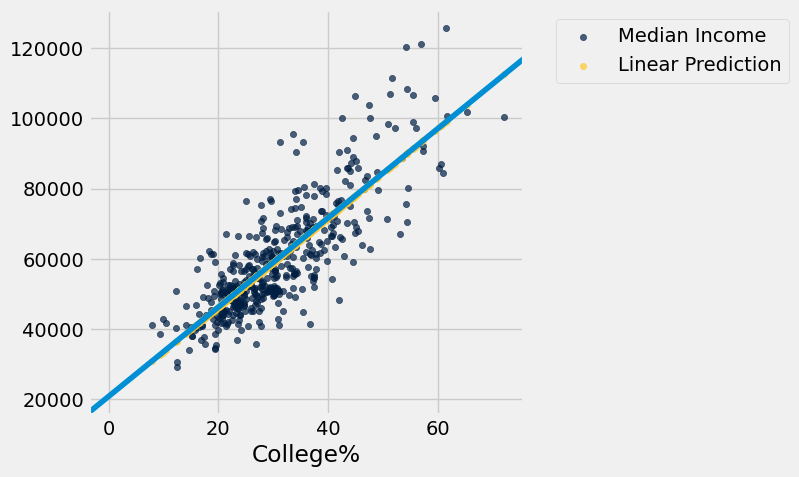

In [19]:
#demographics.scatter('College%', "Median Income")
demographics.scatter('College%', ["Median Income", "Linear Prediction"])
draw_line(demo_intercept, demo_slope)

Is this a good fit? Is it the best fit?

---

<center> Return to Slides </center>

---

## Computing the Error

The error is the difference between the actual and predicted value:

$$
\text{error} = y - y_\text{predicted}
$$

In a future lecture, we will refer to this error as the **residual**.


In [20]:
y = demographics.column('Median Income') # actual, correct values
predicted = predict_linear(demographics, 'College%', 'Median Income')

errors = y - predicted # errors will be an array

In [21]:
demographics = demographics.with_column('Error', errors)
demographics

State,District,Median Income,Percent voting for Clinton,College%,Linear Prediction,Error
Alabama,"Congressional District 1 (115th Congress), Alabama",47083,34.1,24,51299.4,-4216.42
Alabama,"Congressional District 2 (115th Congress), Alabama",42035,33,21.8,48503.9,-6468.87
Alabama,"Congressional District 3 (115th Congress), Alabama",46544,32.3,22.8,49774.6,-3230.58
Alabama,"Congressional District 4 (115th Congress), Alabama",41110,17.4,17,42404.5,-1294.51
Alabama,"Congressional District 5 (115th Congress), Alabama",51690,31.3,30.3,59304.8,-7614.84
Alabama,"Congressional District 6 (115th Congress), Alabama",61413,26.1,36.7,67437.3,-6024.33
Alabama,"Congressional District 7 (115th Congress), Alabama",34664,69.8,19.4,45454.2,-10790.2
Alaska,"Congressional District (at Large) (115th Congress), Alaska",76440,37.6,29.6,58415.3,18024.7
Arizona,"Congressional District 1 (115th Congress), Arizona",50537,46.6,24.5,51934.8,-1397.77
Arizona,"Congressional District 2 (115th Congress), Arizona",49072,49.6,34,64006.4,-14934.4


What are the districts with the largest error values?

In [24]:
(demographics
 .with_column('Abs Error', np.abs(demographics.column('Error')))
 .sort('Abs Error', descending = True)
)


State,District,Median Income,Percent voting for Clinton,College%,Linear Prediction,Error,Abs Error
New York,"Congressional District 2 (115th Congress), New York",93362,43.9,31.2,60448.5,32913.5,32913.5
Maryland,"Congressional District 5 (115th Congress), Maryland",95442,64.1,33.7,63625.2,31816.8,31816.8
Virginia,"Congressional District 10 (115th Congress), Virginia",120384,52.2,54.3,89801.7,30582.3,30582.3
California,"Congressional District 15 (115th Congress), California",106291,69.9,45,77984.2,28306.8,28306.8
California,"Congressional District 17 (115th Congress), California",121150,73.9,57,93232.6,27917.4,27917.4
California,"Congressional District 19 (115th Congress), California",93139,72.9,35.5,65912.5,27226.5,27226.5
California,"Congressional District 18 (115th Congress), California",125790,73.4,61.5,98950.7,26839.3,26839.3
New York,"Congressional District 1 (115th Congress), New York",90435,42.2,34.1,64133.5,26301.5,26301.5
Pennsylvania,"Congressional District 2 (115th Congress), Pennsylvania",41320,72.9,36.7,67437.3,-26117.3,26117.3
Georgia,"Congressional District 5 (115th Congress), Georgia",48269,85,42,74172,-25903,25903


What would a large error suggest?

In [ ]:
# write your response here...


### Visualizing the Errors

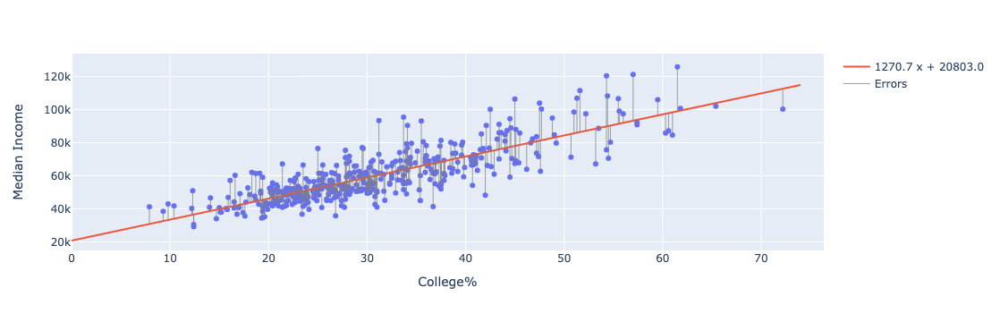

In [25]:
fig = px.scatter(demographics.to_df(), x="College%", y="Median Income", hover_name="District")
xtest = np.arange(0, 75, 1)
fig.add_scatter(x=xtest, 
                y=demo_slope * xtest + demo_intercept,
                name = f"{np.round(demo_slope, 2)} x + {np.round(demo_intercept)}")
fig.add_scatter(x=demographics.column("College%").repeat(3), 
                y=np.ravel(np.vstack([y, predicted, np.nan * predicted]).T),
                marker_color="gray", line_width=0.75, name="Errors")
fig

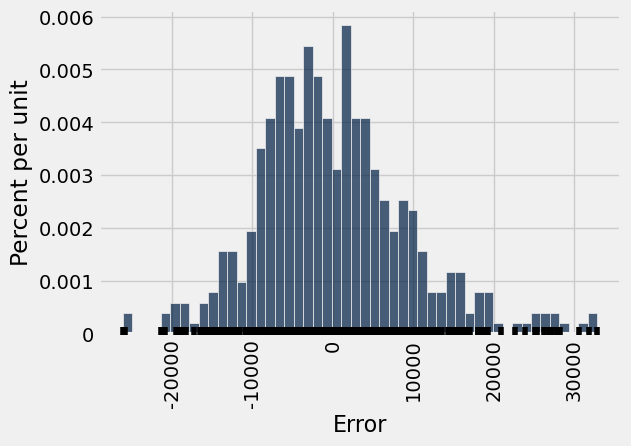

In [26]:
demographics.hist('Error', bins=50, rug=True)

---
## Summarizing the Overall Error

What is the average error?

In [28]:
np.mean(errors)
0.00000000000063560089503211536 
# essentially our average error is 0, since we have negatives and positive values

6.356008950321154e-13

In [29]:
np.sum(errors)

2.7648638933897018e-10

Mean Absolute Error (MAE)

In [30]:
np.mean(np.abs(errors))

7235.9076108913441

Mean Squared Error (MSE)

In [31]:
np.mean(errors ** 2)

88332095.268617392

Root Mean Squared Error (RMSE)

In [32]:
np.sqrt(np.mean(errors ** 2))

9398.5155885712811

#### Discussion Question
Why is the RMSE larger than the MAE?

Assuming $y$ is income in dollars. What are the units of:
1. Mean Absolute Error
2. Mean Squared Error
3. Root Mean Squared Error

In [ ]:
# what are the units of Mean Absolute Error?
# average, absolute value of income in dollars

# units of Mean Squared Error?
# average dollars squared

# units of RMSE?
# average dollars



---

## Error as Function of our Model (Line)

In [33]:
def demographics_rmse(slope, intercept):
    # make a linear prediction using slope and intercept
    predicted = slope * demographics.column('College%') + intercept # y_pred = slope * x + intercept
    actual = demographics.column('Median Income')
    errors = predicted - actual # errors = y_pred - y_actual
    rmse = np.sqrt(np.mean(errors ** 2)) # root mean squared error
    return rmse

The value of our error function for the slope and intercept we derived in last lecture is:

In [34]:
demographics_rmse(demo_slope, demo_intercept) 

9398.5155885712811

What if we used a different slope and intercept value:

In [35]:
def visualize_demographics_rmse(slope, intercept):
    rmse = demographics_rmse(slope, intercept)
    predicted = slope * demographics.column("College%") + intercept 
    actual = demographics.column("Median Income")
    fig = px.scatter(demographics.to_df(), x="College%", y="Median Income")
    xtest = np.arange(0, 75, 1)
    fig.add_scatter(x=xtest, y=slope * xtest + intercept,
                    name = f"{np.round(slope, 2)} x + {np.round(intercept)}")
    fig.add_scatter(x=demographics.column("College%").repeat(3), 
                    y=np.ravel(np.vstack([actual, predicted, np.nan * predicted]).T),
                    marker_color="gray", line_width=0.75, name="Errors")
    fig.update_layout(title=f"RMSE = {np.round(rmse, 2)}")
    return fig

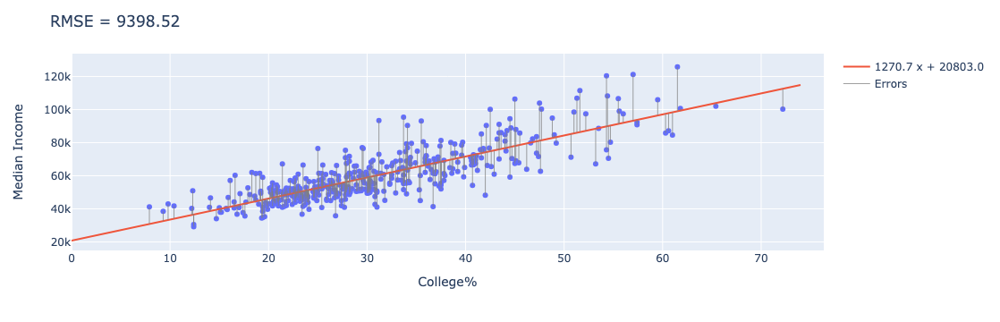

In [36]:
visualize_demographics_rmse(demo_slope, demo_intercept)

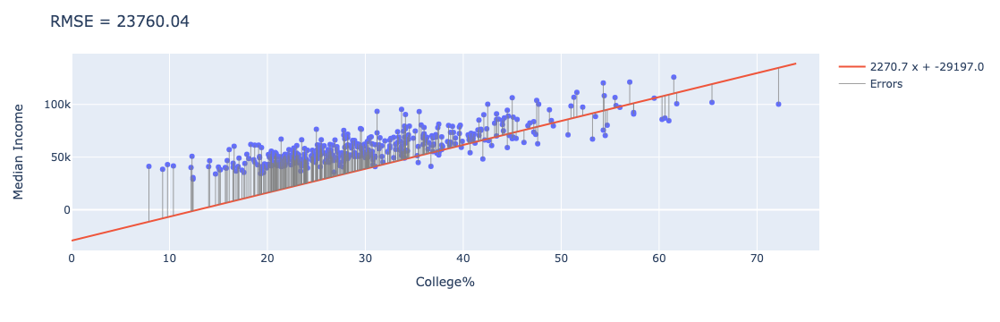

In [37]:
visualize_demographics_rmse(demo_slope+1000, demo_intercept - 50000)

---

Varying the Slope and Intercept and Plotting the RMSE

In [38]:
alt_slopes = demo_slope + np.arange(-20, 20)
rmses = []
for new_slope in alt_slopes:
    rmses = np.append(rmses, demographics_rmse(new_slope, demo_intercept))

variations = Table().with_columns("Slope", alt_slopes, "RMSE", rmses)

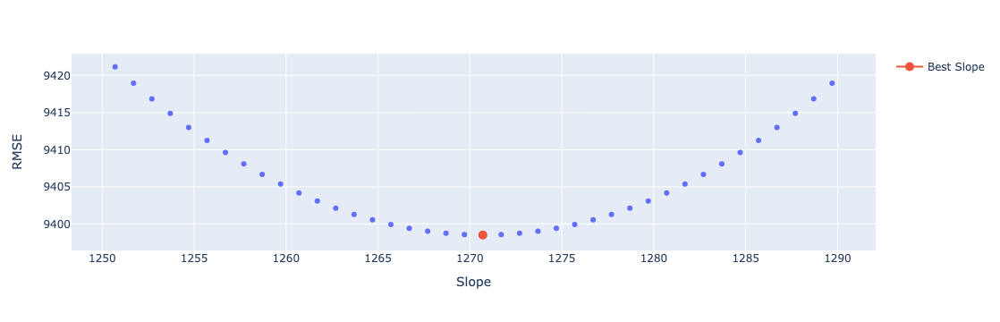

In [39]:
fig = px.scatter(variations.to_df(), x="Slope", y="RMSE")
fig.add_scatter(x=[demo_slope], y=[demographics_rmse(demo_slope, demo_intercept)], marker_size=10, 
                name="Best Slope")

What if we tried to change the intercept value while using the best slope so far?

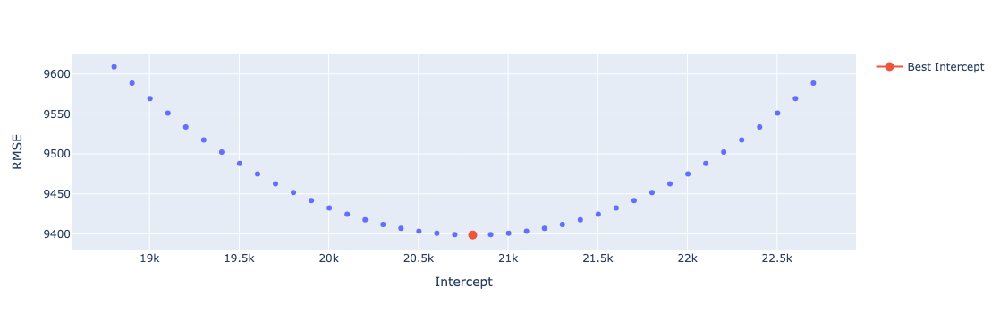

In [40]:
alt_intercepts = demo_intercept + np.arange(-2000, 2000, 100)
rmses = []
for new_intercept in alt_intercepts:
    rmses = np.append(rmses, demographics_rmse(demo_slope, new_intercept))

variations = Table().with_columns("Intercept", alt_intercepts, "RMSE", rmses)
fig = px.scatter(variations.to_df(), x="Intercept", y="RMSE")
fig.add_scatter(x=[demo_intercept], y=[demographics_rmse(demo_slope, demo_intercept)], marker_size=10, 
                name="Best Intercept")

What if we tried changing both the slope and the intercept at the same time?

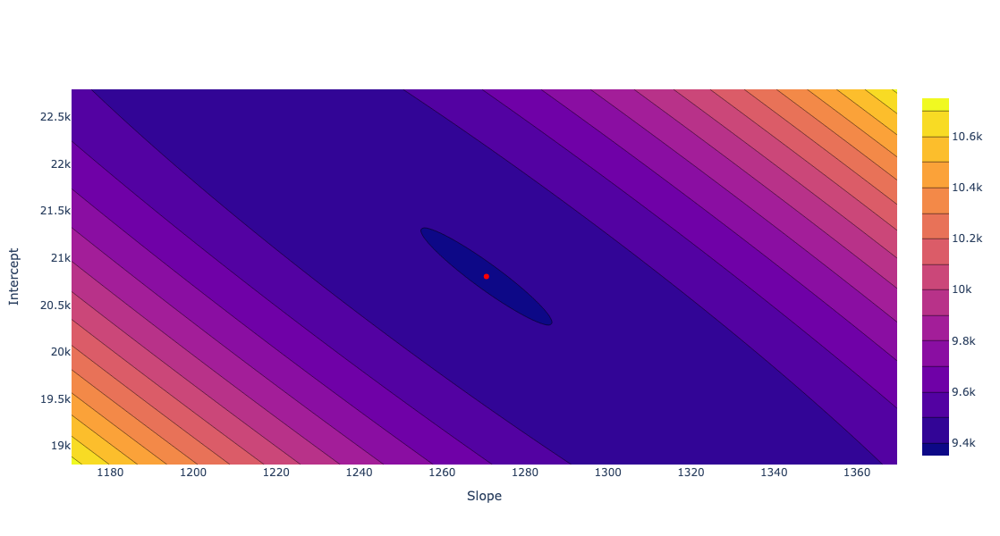

In [41]:
alt_slopes = demo_slope + np.arange(-100, 100, 1)
alt_intercepts = demo_intercept + np.arange(-2000, 2000, 10)
variations = Table(["Slope", "Intercept", "RMSE"])
for new_slope in alt_slopes:
    for new_intercept in alt_intercepts:
        rmse = demographics_rmse(new_slope, new_intercept)
        variations.append([new_slope, new_intercept, rmse])
    
variations
go.Figure(data=[
    go.Contour(x=variations.column("Slope"), y=variations.column("Intercept"), z=variations.column("RMSE")), 
    go.Scatter(x=[demo_slope], y=[demo_intercept], marker_color="red")
],
layout=dict(width = 800,height=600, xaxis_title="Slope", yaxis_title="Intercept"))

In three dimensions:

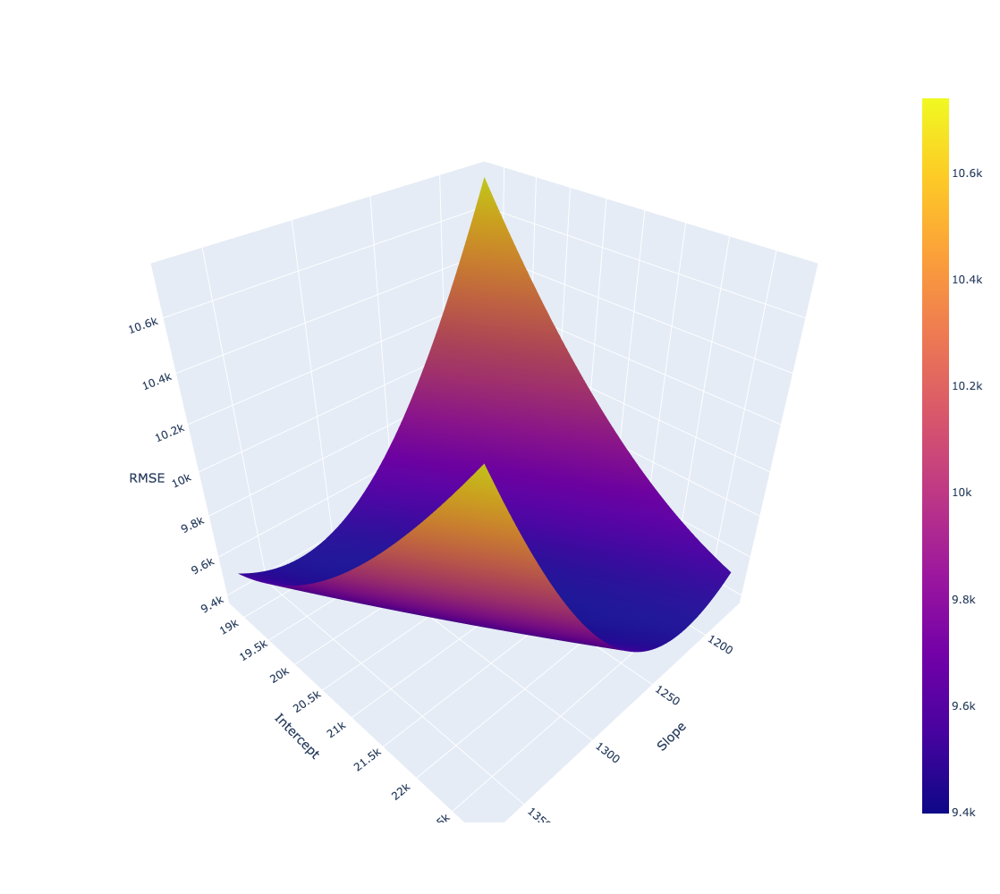

In [42]:
go.Figure(data=[
    go.Surface(x = alt_slopes, y = alt_intercepts,
               z=variations.column("RMSE").reshape(len(alt_slopes), len(alt_intercepts)).T),
               #contours = {"z": {"show": True , 'start': 9400, 'end': 10600, 'size':10}}),                
    go.Scatter3d(x=[demo_slope], y=[demo_intercept], z=[demographics_rmse(demo_slope, demo_intercept)])], 
          layout=dict(height=1000, 
                      scene_xaxis_title="Slope", scene_yaxis_title="Intercept", 
                      scene_zaxis_title="RMSE"))

---

<center> Return to Slides </center>

---

## Numerical Optimization

If our goal is just to find the parameters of our line that minimize some kind of error, we can use numerical optimization tools.  Suppose we wanted to minimize the function:

$$
f(x) = \left(x - 2\right)^2 + 3
$$

In [43]:
def f(x):
    return ((x-2)**2) + 3

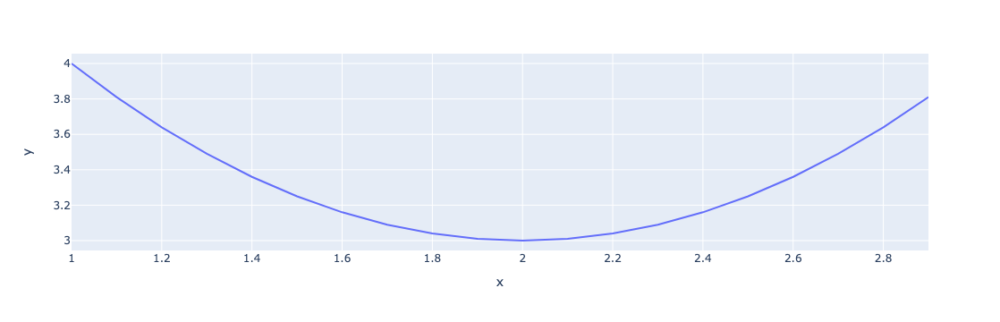

In [44]:
x = np.arange(1, 3, 0.1)
y = f(x)
px.line(x=x, y=y)

We could use the minimize function in the `datascience` package. The function returns the arguments to the functions that result in the minimum value:

$$
\texttt{minimize(f)}\, = \, \arg\min_{a,b, \ldots} f(a,b\ldots)
$$

In [45]:
minimize(f)

1.9999999946252267

In [46]:
print("x_min =", minimize(f))
print("f(x_min) =", f(minimize(f)))

x_min = 1.9999999946252267
f(x_min) = 3.0


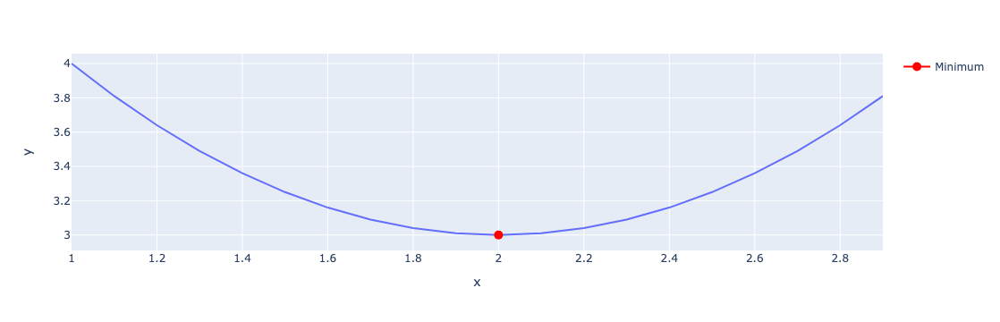

In [47]:
fig = px.line(x=x, y=y)
fig.add_scatter(x=[minimize(f)], y=[f(minimize(f))],
                name="Minimum", marker_color="red", marker_size=10)

Minimize works for even more complex functions.

$$
f(x) = 2 * \sin(\pi x) + x^3 + x^4 + \sin(10x)
$$

In [48]:
def complicated_function(x):
    return 2 * np.sin(x*np.pi) + x ** 3 + x ** 4 + np.sin(x * 10)

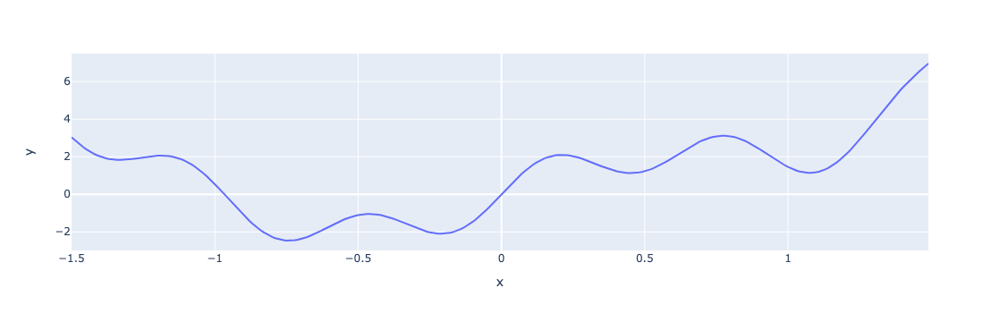

In [49]:
x = np.arange(-1.5, 1.5, 0.01)
y2 = complicated_function(x)
px.line(x=x, y=y2)

We can still use minimize to find the minimum:

In [50]:
x_min = minimize(complicated_function)
print("x_min =", x_min)
print("f(x_min) =", complicated_function(x_min))

x_min = -0.740999069950806
f(x_min) = -2.46205656866


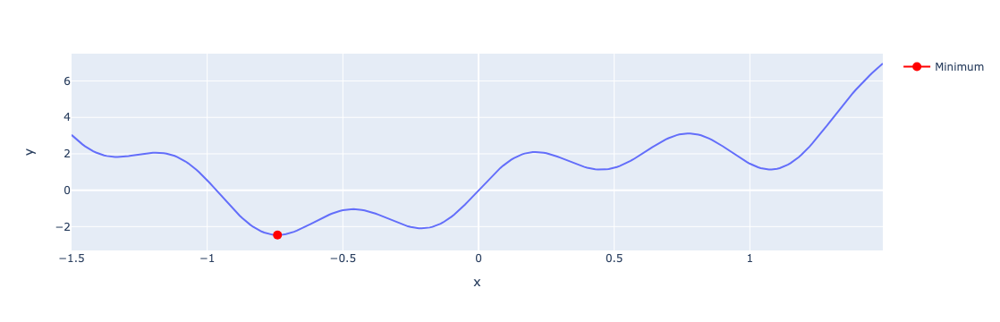

In [51]:
fig = px.line(x=x, y=y2)
fig.add_scatter(x=[x_min],
                y=[complicated_function(x_min)],
                name="Minimum", marker_color="red", marker_size=10)

We can even minimize multidimensional functions:

$$
\texttt{surface_function(a,b)} = -\frac{\cos\left(\pi \sqrt{(a+0.5)^2 + b^2}\right)}{\sqrt{(a+0.5)^2 + b^2} + 1}
$$

In [52]:
def surface_function(a, b):
    d = np.sqrt( (a+0.5)**2 + b**2 )
    return -np.cos(np.pi* d) / (d**2 + 1)

In [53]:
a_min, b_min = minimize(surface_function)
[a_min, b_min]

[-0.49999999724892291, 2.782459398025432e-11]

Visualizing the surface and the minimum:

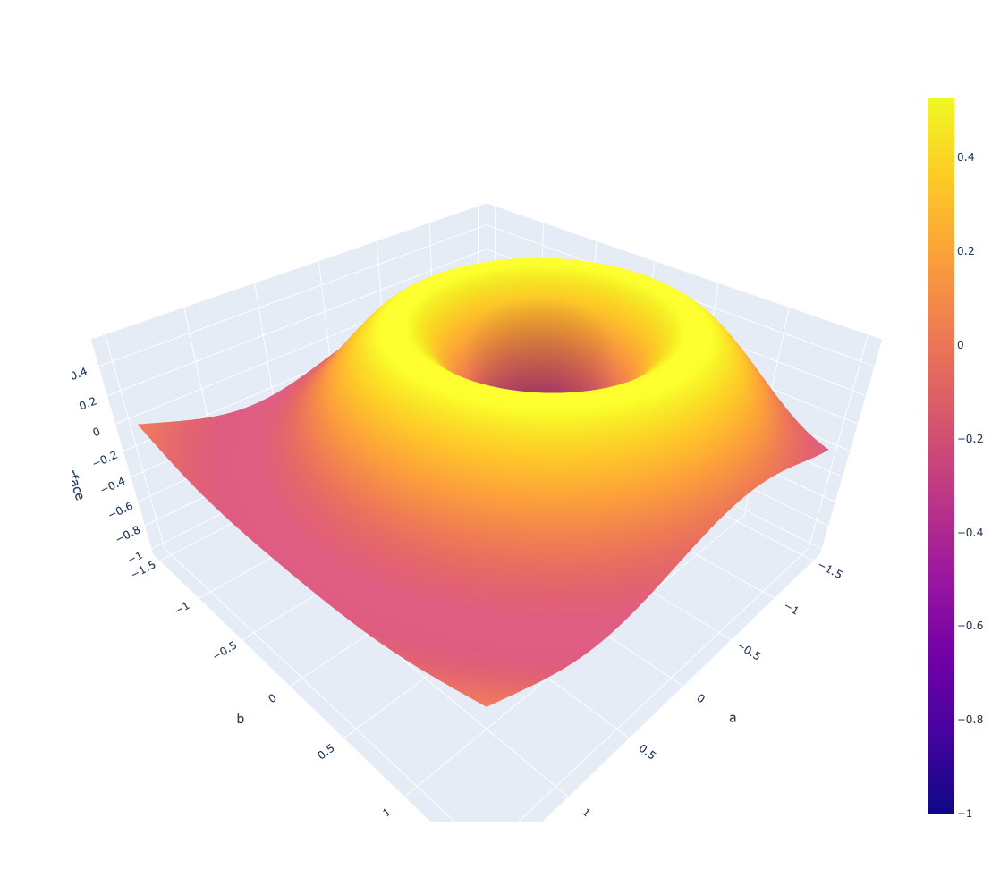

In [54]:
xs = np.arange(-1.5, 1.5, 0.01)
ys = np.arange(-1.5, 1.5, 0.01)
x, y = np.meshgrid(xs, ys)
zs = surface_function(x.flatten(), y.flatten())
go.Figure(data=[
    go.Surface(x = xs, y = ys,
               z=zs.reshape(len(xs), len(ys))),
    go.Scatter3d(x=[a_min], y=[b_min], z=[surface_function(a_min, b_min)])
    ], 
    layout=dict(height=1000, 
                scene_xaxis_title="a", scene_yaxis_title="b", 
                scene_zaxis_title="surface"))

<br><br><br>

---

### Minimizing RMSE 

We can use minimize to find the slope and intercept that minimize root mean squared error in our predictions:

In [55]:
minimize(demographics_rmse)

array([  1270.70168805,  20802.57933807])

How does this compare to the slope and intercept we derived earlier?

In [56]:
[demo_slope, demo_intercept]

[1270.70168946388, 20802.577766677925]

What happens if we minimize the mean squared error instead of the root mean squared error?

In [59]:
def demographics_mse(slope, intercept):
    x = demographics.column('College%')
    y = demographics.column('Median Income')
    estimate = slope * x + intercept
    return np.mean(((y - estimate) ** 2))

In [60]:
minimize(demographics_mse)

array([  1270.70168947,  20802.5777658 ])

What if we wanted to use the absolute error instead?

In [61]:
def demographics_mae(any_slope, any_intercept):
    x = demographics.column('College%')
    y = demographics.column('Median Income')
    estimate = any_slope * x + any_intercept
    return np.mean(np.abs(y - estimate))

In [62]:
minimize(demographics_mae)

array([  1264.71948402,  20001.85902309])

That is different!

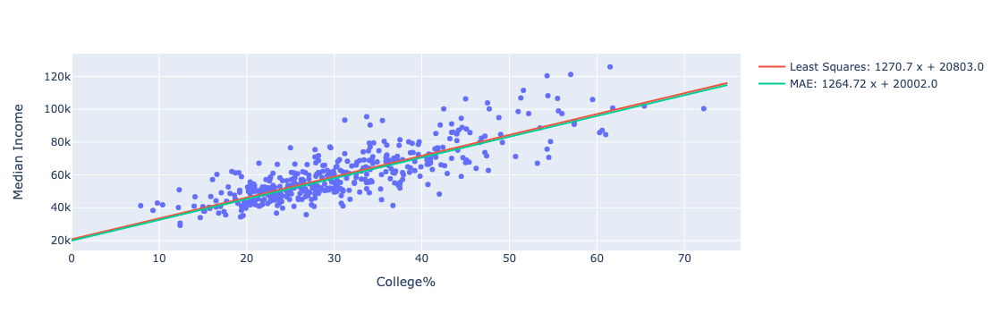

In [63]:
mae_slope, mae_intercept = minimize(demographics_mae)
fig = px.scatter(demographics.to_df(), x="College%", y="Median Income")
xtest = np.arange(0, 75, 0.1)
fig.add_scatter(x=xtest, 
                y=demo_slope * xtest + demo_intercept,
                name = f"Least Squares: {np.round(demo_slope, 2)} x + {np.round(demo_intercept)}")
fig.add_scatter(x=xtest, 
                y=mae_slope * xtest + mae_intercept,
                name = f"MAE: {np.round(mae_slope, 2)} x + {np.round(mae_intercept)}")
fig

---

<center> Return to Slides </center>

---

## Multiple Linear Regression

We can also use multiple variables to help predict a single variable.  

In [ ]:
hybrid = Table.read_table('data/hybrid.csv')
hybrid.show(5)

In [ ]:
px.scatter_3d(
    hybrid.to_df(), 
    x="mpg", y="acceleration", z="msrp",
    hover_name="vehicle", 
    color="class", 
    height=800
)

Suppose we use the model:

$$
price = a * \text{acc} + b * \text{mpg} + c
$$

In [ ]:
def hybrid_rmse(a, b, c):
    ...
    ...
    ...
    ...
    ...
    pass

In [ ]:
a, b, c = minimize(hybrid_rmse)
[a, b, c]

In [ ]:
print(f"Error: {hybrid_rmse(a, b, c):_}")

In [ ]:
mpg_range = np.arange(10, 80)
acceleration_range = np.arange(5, 25)
predictions = Table(["mpg", "acc", "pred"])
for mpg in mpg_range:
    for acc in acceleration_range: 
        pred = a * acc + b * mpg + c
        predictions.append([mpg, acc, pred])

In [ ]:
fig = px.scatter_3d(
    hybrid.to_df(), 
    x="mpg", y="acceleration", z="msrp",
    hover_name="vehicle", 
    color="class", 
    height=800
)

fig.add_surface(
    x = mpg_range, 
    y = acceleration_range,
    z = predictions.column("pred").reshape(len(mpg_range), len(acceleration_range)).T,
    showscale=False
)

## Fitting Non-linear Data

We could try to improve our predictions by defining a more complex equation:

$$
price = a * \text{acc} + b *\text{mpg} + c * \text{acc}^2  + d * \text{mpg}^2 + e 
$$



In [ ]:
def hybrid_better_rmse(a, b, c, d, e):
    ...
    ...
    ...
    ...
    ...
    pass

In [ ]:
a, b, c, d, e = minimize(hybrid_better_rmse)
[a, b, c, d, e]

In [ ]:
print(f"Error: {hybrid_better_rmse(a,b,c,d,e):,}")

In [ ]:
mpg_range = np.arange(10, 80)
acceleration_range = np.arange(5, 25)
predictions = Table(["mpg", "acc", "pred"])
for mpg in mpg_range:
    for acc in acceleration_range: 
        pred = a*acc + b*mpg + c*acc**2 + d*mpg**2 + e
        predictions.append([mpg, acc, pred])
        
fig = px.scatter_3d(
    hybrid.to_df(), 
    x="mpg", y="acceleration", z="msrp",
    hover_name="vehicle", 
    color="class", 
    height=800
)
fig.add_surface(
    x = mpg_range, y = acceleration_range,
    z = predictions.column("pred").reshape(len(mpg_range), len(acceleration_range)).T,
    showscale=False
)